<a href="https://colab.research.google.com/github/fvillena/patrones/blob/main/6-deep_learning_1.sol.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Deep learning 1

Deep learning es un tipo de aprendizaje de máquinas en donde las predicciones se realizan a través de una serie de operaciones matriciales concatenadas. Uno de los elementos más importantes en el Deep Learning es la casi nula ingeniería de características. En el ejemplo que veremos ahora, se utiliza un conjunto de imágenes segmentadas para realizar el entrenamiento de un modelo de segmentación automática de núcleos celulares, este entrenamiento simplemente se realiza con los pixeles crudos de las imágenes, sin ingeniería de características.


In [1]:
import tensorflow as tf # Biblioteca de redes neuronales
import pandas as pd # # Biblioteca de manejo de conjuntos de datos
import sklearn.preprocessing # Preprocesamiento de datos
import sklearn.model_selection # # Funciones para preparar nuestro conjunto de datos
import sklearn.metrics # Métricas
import matplotlib.pyplot as plt # Biblioteca de visualización
import numpy as np # Biblioteca de álgebra lineal
import scipy.stats
import os
import PIL
import datetime

## Red fully connected

Utilizaremos un conjunto de datos que relaciones características fisiológicas extraídas a través de un dispositivo vestible con tipos de actividades que los sujetos estaban realizando en ese momento.

El conjunto de datos es del artículo Activity Recognition Using Wearable Physiological Measurements: Selection of Features from a Comprehensive Literature Study https://pubmed.ncbi.nlm.nih.gov/31847261/

In [2]:
data = pd.read_csv("https://raw.githubusercontent.com/fvillena/patrones/main/data/activity_recognition.csv")

In [3]:
data.head()

,ecg_original_mean,ecg_original_std,ecg_original_trimmean25,ecg_original_median,ecg_original_skewness,ecg_original_kurtosis,ecg_original_max,ecg_original_min,ecg_original_prctile25,ecg_original_prctile75,ecg_original_geomean(abs),ecg_original_harmmean,ecg_original_mad,ecg_original_baseline,ecg_rr_window_mean,ecg_rr_window_std,ecg_rr_window_trimmean25,ecg_rr_window_median,ecg_rr_window_skewness,ecg_rr_window_kurtosis,ecg_rr_window_max,ecg_rr_window_min,ecg_rr_window_prctile25,ecg_rr_window_prctile75,ecg_rr_window_geomean(abs),ecg_rr_window_harmmean,ecg_rr_window_mad,ecg_rr_window_baseline,ecg_amplitude_rr_mean,ecg_amplitude_rr_std,ecg_amplitude_rr_trimmean25,ecg_amplitude_rr_median,ecg_amplitude_rr_skewness,ecg_amplitude_rr_kurtosis,ecg_amplitude_rr_max,ecg_amplitude_rr_min,ecg_amplitude_rr_prctile25,ecg_amplitude_rr_prctile75,ecg_amplitude_rr_geomean(abs),ecg_amplitude_rr_harmmean,...,eda_functionals_power_originalmedian_1,eda_functionals_power_originalskewness_1,eda_functionals_power_originalkurtosis_1,eda_functionals_power_originalmax_1,eda_functionals_power_originalmin_1,eda_functionals_power_originalprctile25_1,eda_functionals_power_originalprctile75_1,eda_functionals_power_originalgeomean(abs)_1,eda_functionals_power_originalharmmean_1,eda_functionals_power_originalmad_1,eda_functionals_power_originalbaseline_1,eda_functionals_power_fil12mean_1,eda_functionals_power_fil12std_1,eda_functionals_power_fil12trimmean25_1,eda_functionals_power_fil12median_1,eda_functionals_power_fil12skewness_1,eda_functionals_power_fil12kurtosis_1,eda_functionals_power_fil12max_1,eda_functionals_power_fil12min_1,eda_functionals_power_fil12prctile25_1,eda_functionals_power_fil12prctile75_1,eda_functionals_power_fil12geomean(abs)_1,eda_functionals_power_fil12harmmean_1,eda_functionals_power_fil12mad_1,eda_functionals_power_fil12baseline_1,eda_functionals_power_filt2mean_1,eda_functionals_power_filt2std_1,eda_functionals_power_filt2trimmean25_1,eda_functionals_power_filt2median_1,eda_functionals_power_filt2skewness_1,eda_functionals_power_filt2kurtosis_1,eda_functionals_power_filt2max_1,eda_functionals_power_filt2min_1,eda_functionals_power_filt2prctile25_1,eda_functionals_power_filt2prctile75_1,eda_functionals_power_filt2geomean(abs)_1,eda_functionals_power_filt2harmmean_1,eda_functionals_power_filt2mad_1,eda_functionals_power_filt2baseline_1,activity
0,0.022200,0.278189,0.047467,0.067892,-0.734477,3.62217,0.838892,-1.442110,-0.136108,0.220892,0.148904,-0.030990,0.218491,-0.047154,220.222,9.63396,220.030,220.0,0.034521,2.29131,239,198,213.0,228.00,220.016,219.810,8.00494,206.554,0.442348,0.248257,0.461303,0.492892,-0.684694,3.17243,0.838892,-0.293108,0.258892,0.623892,0.381859,0.395202,...,7.71815,31.4386,1015.81,9.477560e+08,0.007747,3.32735,23.39230,10.78430,1.698340,1866460.0,974023.0,935482.0,27223500.0,12.15580,6.839140,31.4387,1015.81,9.477830e+08,0.000230,2.436710,20.31770,7.26835,0.083907,1866510.0,973985.0,577858.0,16816100.0,9.70025,5.04522,31.4387,1015.81,585451000.0,0.006724,2.43873,15.87360,7.39725,1.264500,1152950.0,601642.0,neutral
1,-0.001098,0.210017,-0.048560,-0.090702,2.137990,8.33018,1.244300,-0.290702,-0.127702,0.048299,0.108345,0.359857,0.152568,0.001543,196.400,11.03240,196.079,195.5,0.154292,1.88380,220,178,187.0,205.00,196.097,195.796,9.61600,197.874,0.977553,0.092801,0.978452,0.992298,0.091139,3.04589,1.244300,0.806298,0.911798,1.038300,0.973214,0.968848,...,11.41600,31.4542,1016.43,1.281250e+09,0.025585,5.54921,36.33400,17.65220,3.558140,2520990.0,737197.0,1263960.0,36797200.0,16.13900,8.975790,31.4535,1016.41,1.280810e+09,0.004430,3.220690,26.92650,10.21880,0.540291,2520240.0,737173.0,780770.0,22729800.0,15.76400,8.09887,31.4535,1016.41,791163000.0,0.014209,4.13302,25.89920,12.76960,2.771000,1556760.0,455372.0,mental
2,0.004552,0.148971,-0.004151,0.014918,0.400160,2.78112,0.516918,-0.386082,-0.126082,0.100918,0.087745,-0.028435,0.122477,0.000050,213.304,7.21378,213.706,214.0,-0.332257,2.85548,229,196,209.0,218.00,213.

El conjunto de datos cuenta con **533 características** de mediciones de Electrocardiograma (ECG), Bioimpedancia Eléctrica Torácica (TEB) y la Actividad Ectodérmica (EDA) for activity recognition.

Las actividades etiquetadas a cada punto de datos son Neutral, Emocional, Mental y Física

In [4]:
features = data.iloc[:,:-1]
label = data.activity

Escalamos nuestras características utilizando un Min-Max Scaler.

In [5]:
scaler = sklearn.preprocessing.MinMaxScaler()
features_scaled = scaler.fit_transform(features)

Nuestras etiquetas son discretas, por lo que las transformamos con un codificador One-Hot

In [6]:
encoder = sklearn.preprocessing.LabelEncoder() # Label encoder de sklearn que mapea las categorías a números enteros
label_encoded = encoder.fit_transform(label)
label_encoded = tf.keras.utils.to_categorical(label_encoded) # Implementación de Tensorflow del One-Hot Encoding

Separamos el conjunto de datos en un subconjunto de entrenamiento, validación y prueba.

In [7]:
features_train, features_test, label_train, label_test = sklearn.model_selection.train_test_split(
    features_scaled,
    label_encoded,
    random_state=11
)
features_train, features_val, label_train, label_val = sklearn.model_selection.train_test_split(
    features_train,
    label_train,
    test_size=0.1,
    random_state=11
)

Diseñamos la arquitectura de nuestra red neuronal.

In [8]:
model = tf.keras.Sequential([ # Este objeto recibe una lista de capas.
    tf.keras.layers.Dense(128, activation='relu'), # Capa densa de 128 neuronas con una activación ReLU
    tf.keras.layers.Dense(len(encoder.classes_), activation='softmax') # Capa densa de clasificación 
                                                                       # con una activación Softmax
                                                                       # la cantidad de neuronas de esta capa 
                                                                       # debe ser igual a la cantidad de clases
])

Configuramos el modelo para el entrenamiento

In [9]:
model.compile(optimizer='adam', # Utilizamos un optimizador ADAM
              loss='categorical_crossentropy', # Usamos entropía cruzada categórica porque nuestro problema es de clasificación de más de 2 clases
              metrics=['accuracy']) # Medimos el rendimiento del modelo con la exactitud

Ajustamos el modelo

In [10]:
history = model.fit( # Guardamos el historial del modelo
          features_scaled,
          label_encoded,
          epochs=10, # Detenemos el entrenamiento al llegar a 10 épocas
          validation_data=(features_val,label_val) # Al final de cada época probamos el rendimiento en el conjunto de validación
          )

Epoch 1/10
140/140 [==============================] - 4s 5ms/step - loss: 0.9577 - accuracy: 0.5986 - val_loss: 0.5751 - val_accuracy: 0.7411
Epoch 2/10
140/140 [==============================] - 0s 2ms/step - loss: 0.5798 - accuracy: 0.7364 - val_loss: 0.5099 - val_accuracy: 0.7708
Epoch 3/10
140/140 [==============================] - 0s 2ms/step - loss: 0.5178 - accuracy: 0.7550 - val_loss: 0.4605 - val_accuracy: 0.8036
Epoch 4/10
140/140 [==============================] - 0s 2ms/step - loss: 0.4842 - accuracy: 0.7812 - val_loss: 0.4316 - val_accuracy: 0.8125
Epoch 5/10
140/140 [==============================] - 0s 2ms/step - loss: 0.4418 - accuracy: 0.7963 - val_loss: 0.4487 - val_accuracy: 0.8095
Epoch 6/10
140/140 [==============================] - 0s 2ms/step - loss: 0.4319 - accuracy: 0.7986 - val_loss: 0.3972 - val_accuracy: 0.8095
Epoch 7/10
140/140 [==============================] - 0s 2ms/step - loss: 0.4127 - accuracy: 0.8097 - val_loss: 0.4220 - val_accuracy: 0.7946
Epoch 

Visualizamos el rendimiento de nuestro modelo al avanzar las épocas.

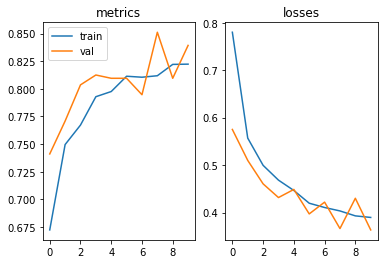

In [11]:
fig, axs = plt.subplots(1,2)
axs[0].plot(
    history.history["accuracy"],
    label="train"
)
axs[0].plot(
    history.history["val_accuracy"],
    label="val"
)
axs[0].set_title("metrics")
axs[1].plot(
    history.history["loss"]
)
axs[1].plot(
    history.history["val_loss"]
)
axs[1].set_title("losses")
axs[0].legend()

Verificamos el rendimiento en el conjunto de prueba

In [12]:
predictions = model.predict(features_test)

In [13]:
print(sklearn.metrics.classification_report(
    label_test.argmax(axis=1), # Utilizamos argmax para obtener la etiqueta de cada punto de datos
    predictions.argmax(axis=1)
))

              precision    recall  f1-score   support

           0       0.63      0.91      0.74       267
           1       0.84      0.51      0.63       292
           2       0.94      0.93      0.93       297
           3       0.99      0.99      0.99       264

    accuracy                           0.83      1120
   macro avg       0.85      0.83      0.82      1120
weighted avg       0.85      0.83      0.82      1120



### Actividad 1

Aumenta la cantidad de épocas y describe cómo se comportan las métricas al aumentar la cantidad de épocas.

In [70]:
history_2 = model.fit( # Guardamos el historial del modelo
          features_scaled,
          label_encoded,
          epochs=200, # Detenemos el entrenamiento al llegar a 10 épocas
          validation_data=(features_val,label_val) # Al final de cada época probamos el rendimiento en el conjunto de validación
          )

Epoch 1/200
140/140 [==============================] - 0s 2ms/step - loss: 0.1859 - accuracy: 0.9225 - val_loss: 0.1758 - val_accuracy: 0.9107
Epoch 2/200
140/140 [==============================] - 0s 2ms/step - loss: 0.1793 - accuracy: 0.9223 - val_loss: 0.1531 - val_accuracy: 0.9345
Epoch 3/200
140/140 [==============================] - 0s 2ms/step - loss: 0.1853 - accuracy: 0.9150 - val_loss: 0.1762 - val_accuracy: 0.9137
Epoch 4/200
140/140 [==============================] - 0s 2ms/step - loss: 0.1770 - accuracy: 0.9237 - val_loss: 0.1776 - val_accuracy: 0.9196
Epoch 5/200
140/140 [==============================] - 0s 2ms/step - loss: 0.1751 - accuracy: 0.9225 - val_loss: 0.1522 - val_accuracy: 0.9375
Epoch 6/200
140/140 [==============================] - 0s 2ms/step - loss: 0.1709 - accuracy: 0.9286 - val_loss: 0.1627 - val_accuracy: 0.9226
Epoch 7/200
140/140 [==============================] - 0s 2ms/step - loss: 0.1810 - accuracy: 0.9179 - val_loss: 0.2083 - val_accuracy: 0.8899

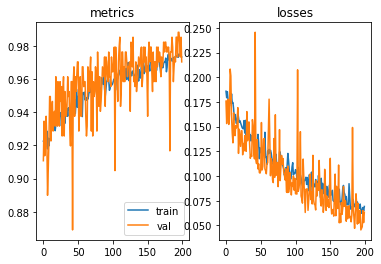

In [71]:
fig, axs = plt.subplots(1,2)
axs[0].plot(
    history_2.history["accuracy"],
    label="train"
)
axs[0].plot(
    history_2.history["val_accuracy"],
    label="val"
)
axs[0].set_title("metrics")
axs[1].plot(
    history_2.history["loss"]
)
axs[1].plot(
    history_2.history["val_loss"]
)
axs[1].set_title("losses")
axs[0].legend()

### Actividad 2

Implementa manualmente las operaciones que se deben realizar con los pesos ajustados de la red neuronal para predecir sobre el conjunto de prueba.

El módulo `tensorflow.nn` te va a ser de mucha ayuda https://www.tensorflow.org/api_docs/python/tf/nn

Para extraer los pesos de cada capa revisa la documentación de

Modelo de keras: https://www.tensorflow.org/api_docs/python/tf/keras/Model
Capa de keras: https://www.tensorflow.org/api_docs/python/tf/keras/layers/Layer#get_weights

In [72]:
tf.nn.softmax(
  tf.tensordot(
    tf.nn.relu(
      tf.tensordot(
        features_test.astype(np.float32),
        model.layers[0].get_weights()[0],
        1
      )  + model.layers[0].get_weights()[1]
    ),
    model.layers[1].get_weights()[0],
    1
  ) + model.layers[1].get_weights()[1]
)

<tf.Tensor: shape=(1120, 4), dtype=float32, numpy=
array([[9.92125750e-01, 7.76434084e-03, 1.09824992e-04, 2.34389754e-18],
       [1.46829634e-05, 9.99985337e-01, 3.17351230e-08, 5.75452706e-12],
       [1.23730886e-18, 5.98810405e-17, 1.32885876e-38, 1.00000000e+00],
       ...,
       [8.78594100e-01, 1.21405885e-01, 1.95988330e-14, 4.29653119e-11],
       [9.54114014e-27, 1.58293014e-16, 4.51744031e-31, 1.00000000e+00],
       [1.42769920e-06, 9.99997616e-01, 9.24854362e-07, 8.35713822e-13]],
      dtype=float32)>

## Red convolucional

Exploraremos cómo se realizan las transformaciones de los datos al transitar por una red convolucional.

In [15]:
def nice_image_printer(model, image):
    """prints the cat as a 2d array"""
    image_batch = np.expand_dims(image,axis=0)
    conv_image2 = model.predict(image_batch)
    
    conv_image2 = np.squeeze(conv_image2, axis=0)
    conv_image2 = conv_image2.reshape(conv_image2.shape[:2])

    plt.imshow(conv_image2)
    plt.colorbar()

def gkern(kernlen=[21,21], nsig=[3, 3]):
    """Returns a 2D Gaussian kernel array."""

    assert len(nsig) == 2
    assert len(kernlen) == 2
    kern1d = []
    for i in range(2):
        interval = (2*nsig[i]+1.)/(kernlen[i])
        x = np.linspace(-nsig[i]-interval/2., nsig[i]+interval/2., kernlen[i]+1)
        kern1d.append(np.diff(scipy.stats.norm.cdf(x)))

    kernel_raw = np.sqrt(np.outer(kern1d[0], kern1d[1]))
    kernel = kernel_raw/kernel_raw.sum()
    return kernel

def kernel_init(shape, dtype=None, partition_info=None):
    """Kernel initializer"""
    kernel = np.zeros(shape)
    kernel[:,:,0,0] = gkern([shape[0], shape[1]])
    return kernel 

Cargamos y preprocesamos nuestro conjunto de datos.

In [16]:
!wget https://raw.githubusercontent.com/fvillena/patrones/main/data/cat.png

--2021-05-11 22:17:58--  https://raw.githubusercontent.com/fvillena/patrones/main/data/cat.png
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.111.133, 185.199.109.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 291073 (284K) [image/png]
Saving to: ‘cat.png’

cat.png             100%[===================>] 284.25K  --.-KB/s    in 0.007s  

2021-05-11 22:17:59 (41.3 MB/s) - ‘cat.png’ saved [291073/291073]



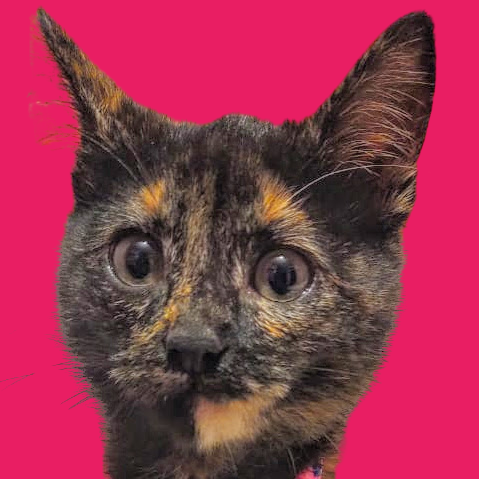

In [17]:
cat = tf.keras.preprocessing.image.load_img("cat.png") # Importamos la imagen
cat # Visualizamos la imagen

In [18]:
cat_array = tf.keras.preprocessing.image.img_to_array(cat) / 255 # Transformamos la imagen en un arreglo y lo normalizamos entre 0 y 1.

In [19]:
cat_array.shape # Estas son las dimensiones de nuestra imagen (largo, ancho, canales)

(479, 479, 3)

Instanciamos nuestro primer modelo con una capa única de convolución.

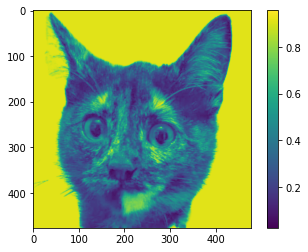

In [20]:
cat_model_1 = tf.keras.Sequential([
  tf.keras.layers.Conv2D( # Capa convolucional
      filters = 1, # Sólo utilizaremos 1 kernel
      kernel_size = (3,3), # Estas son las dimensiones del kernel
      input_shape = cat_array.shape, # Estas son las dimensiones de entrada de la red.
      kernel_initializer = kernel_init # Utilizamos un kernel gausiano que lo generamos con nuestro inicializador
  )
])
nice_image_printer(cat_model_1, cat_array)

Aumentamos el tamaño del kernel.

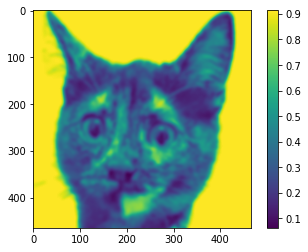

In [21]:
cat_model_2 = tf.keras.Sequential([
  tf.keras.layers.Conv2D(
      filters = 1,
      kernel_size = (15,15), # Ahora el kernel es de 15*15
      input_shape = cat_array.shape,
      kernel_initializer = kernel_init
  )
])
nice_image_printer(cat_model_2, cat_array)

Agregamos una función de activación sigmoidea. Nótese que cambió el rango de los valores (mirar la  barra de color).

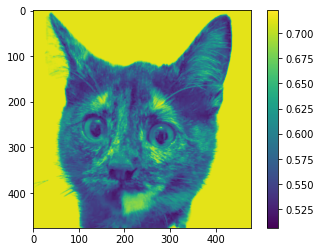

In [22]:
cat_model_3 = tf.keras.Sequential([
  tf.keras.layers.Conv2D(
      filters = 1,
      kernel_size = (3,3),
      input_shape = cat_array.shape,
      activation="sigmoid", # Agregamos la función de activación.
      kernel_initializer = kernel_init
  ),
])
nice_image_printer(cat_model_3, cat_array)

Agregamos una capa de Max Pooling.

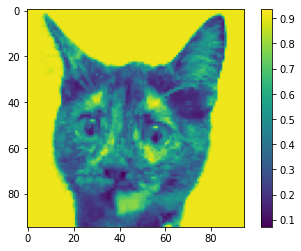

In [23]:
cat_model_4 = tf.keras.Sequential([
  tf.keras.layers.Conv2D(
      filters = 1,
      kernel_size = (3,3),
      input_shape = cat_array.shape,
      kernel_initializer = kernel_init
  ),
  tf.keras.layers.MaxPool2D( # capa de max pooling
      pool_size = (5,5) # Este es el tamaño del max pooling.
  )
])
nice_image_printer(cat_model_4, cat_array)

Agregamos una función de activación y max pooling.

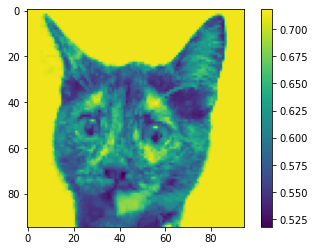

In [24]:
cat_model_5 = tf.keras.Sequential([
  tf.keras.layers.Conv2D(
      filters = 1,
      kernel_size = (3,3),
      input_shape = cat_array.shape,
      activation = "sigmoid",
      kernel_initializer = kernel_init
  ),
  tf.keras.layers.MaxPool2D(
      pool_size = (5,5)
  )
])
nice_image_printer(cat_model_5, cat_array)

Generamos un modelo con múltiples capas de convolución, max pooling y funciones de activación.

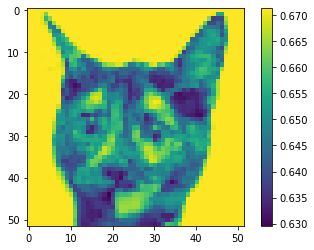

In [25]:
cat_model_6 = tf.keras.Sequential([
  tf.keras.layers.Conv2D(
      filters = 1,
      kernel_size = (3,3),
      input_shape = cat_array.shape,
      activation = "sigmoid",
      kernel_initializer = kernel_init
  ),
  tf.keras.layers.MaxPool2D(
      pool_size = (3,3)
  ),
  tf.keras.layers.Conv2D(
      filters = 1,
      kernel_size = (3,3),
      input_shape = cat_array.shape,
      activation = "sigmoid",
      kernel_initializer = kernel_init
  ),
  tf.keras.layers.MaxPool2D(
      pool_size = (3,3)
  )
])
nice_image_printer(cat_model_6, cat_array)

### Actividad 3

Modifica la última arquitectura utilizando otro kernel y visualiza los resultados. Puedes inspirarte con https://es.wikipedia.org/wiki/N%C3%BAcleo_(procesamiento_digital_de_im%C3%A1genes).



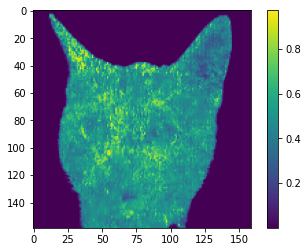

In [80]:
kernel = np.array(
    [
     [-1,-1,-1],
     [-1, 8,-1],
     [-1,-1,-1]
    ]
)
kernel = np.stack([kernel,kernel,kernel])
kernel = np.expand_dims(kernel, axis=-1)
bias = np.array([0])
weights = [kernel,bias]

cat_model_7 = tf.keras.Sequential([
  tf.keras.layers.Conv2D( # Capa convolucional
      filters = 1, # Sólo utilizaremos 1 kernel
      kernel_size = (3,3), # Estas son las dimensiones del kernel
      input_shape = cat_array.shape, # Estas son las dimensiones de entrada de la red.
      kernel_initializer = kernel_init, # Utilizamos un kernel gausiano que lo generamos con nuestro inicializador
      weights = weights,
      activation = "sigmoid"
  ),
  tf.keras.layers.MaxPool2D(
      pool_size = (3,3)
  )
])
nice_image_printer(cat_model_7, cat_array)

## Clasificación de radiografías de tórax

Para este notebook se utilizaron los datos de https://www.cell.com/cell/fulltext/S0092-8674(18)30154-5 y código de https://www.kaggle.com/sanwal092/intro-to-cnn-using-keras-to-predict-pneumonia

In [27]:
%load_ext tensorboard

In [28]:
# Obtenemos el conjunto de datos desde el servidor de SASIBA.
!wget --no-check-certificate "http://www.sasiba.uchile.cl/index.php/s/u0YVAFP5jkDqhp2/download" -O chest_xray.zip

--2021-05-11 22:18:30--  http://www.sasiba.uchile.cl/index.php/s/u0YVAFP5jkDqhp2/download
Resolving www.sasiba.uchile.cl (www.sasiba.uchile.cl)... 200.89.79.35
Connecting to www.sasiba.uchile.cl (www.sasiba.uchile.cl)|200.89.79.35|:80... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://www.sasiba.uchile.cl/index.php/s/u0YVAFP5jkDqhp2/download [following]
--2021-05-11 22:18:31--  https://www.sasiba.uchile.cl/index.php/s/u0YVAFP5jkDqhp2/download
Connecting to www.sasiba.uchile.cl (www.sasiba.uchile.cl)|200.89.79.35|:443... connected.
  Unable to locally verify the issuer's authority.
HTTP request sent, awaiting response... 200 OK
Length: 1225631155 (1.1G) [application/zip]
Saving to: ‘chest_xray.zip’

chest_xray.zip      100%[===================>]   1.14G  23.0MB/s    in 52s     

2021-05-11 22:19:23 (22.4 MB/s) - ‘chest_xray.zip’ saved [1225631155/1225631155]



In [29]:
# Descomprimimos el conjunto de datos.
!unzip -q chest_xray.zip -d chest_xray/

In [30]:
# Configuramos las rutas de los datos
train_folder= 'chest_xray/train/'
val_folder = 'chest_xray/val/'
test_folder = 'chest_xray/test/'
train_n = train_folder+'NORMAL/'
train_p = train_folder+'PNEUMONIA/'

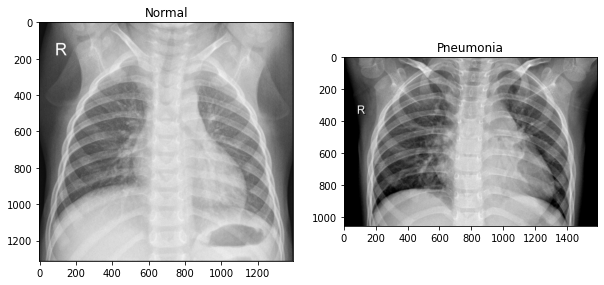

In [31]:
# Miramos un par de radiografías normales y patólogicas al azar

rand_norm= np.random.randint(0,len(os.listdir(train_n)))
norm_pic = os.listdir(train_n)[rand_norm]

norm_pic_address = train_n+norm_pic

rand_p = np.random.randint(0,len(os.listdir(train_p)))

sic_pic =  os.listdir(train_p)[rand_norm]
sic_address = train_p+sic_pic

norm_load = PIL.Image.open(norm_pic_address)
sic_load = PIL.Image.open(sic_address)

f = plt.figure(figsize= (10,6))
a1 = f.add_subplot(1,2,1)
img_plot = plt.imshow(norm_load, cmap="gray")
a1.set_title('Normal')

a2 = f.add_subplot(1, 2, 2)
img_plot = plt.imshow(sic_load, cmap="gray")
a2.set_title('Pneumonia')

plt.show()

In [32]:
# Configuramos el generador de datos que utilizará nuestra red

batch_size = 32

# Queremos aumentar los datos del conjunto de prueba al generar imágenes sintéticas distorisionadas
train_datagen = tf.keras.preprocessing.image.ImageDataGenerator(rescale = 1./255, # A las imágenes se les normaliza el brillo
                                   shear_range = 0.2, # Distorsionamos las imágenes
                                   zoom_range = 0.2, # Acercamos las imágenes
                                   horizontal_flip = True) # Volteamos horizontalmente las imágenes

test_datagen = tf.keras.preprocessing.image.ImageDataGenerator(rescale = 1./255)

training_set = train_datagen.flow_from_directory(train_folder,
                                                 target_size = (64, 64), # Las imágenes se redimensionan a 64*64
                                                 batch_size = batch_size,
                                                 class_mode = 'binary',
                                                 color_mode="grayscale") # Sólo utilizamos el canal de brillo

val_set = test_datagen.flow_from_directory(val_folder,
                                            target_size=(64, 64),
                                            batch_size=batch_size,
                                            class_mode='binary',
                                            shuffle = False,
                                            color_mode="grayscale")

test_set = test_datagen.flow_from_directory(test_folder,
                                            target_size = (64, 64),
                                            batch_size = batch_size,
                                            class_mode = 'binary',
                                            shuffle = False,
                                            color_mode="grayscale")

Found 5216 images belonging to 2 classes.
Found 16 images belonging to 2 classes.
Found 624 images belonging to 2 classes.


In [33]:
# Construimos la arquitectura de la red neuronal

cnn = tf.keras.Sequential()

cnn.add(tf.keras.layers.Conv2D(32, (3, 3), activation="relu", input_shape=(64, 64, 1))) # Capa de convolución

cnn.add(tf.keras.layers.MaxPooling2D(pool_size = (2, 2)))

cnn.add(tf.keras.layers.Conv2D(32, (3, 3), activation="relu"))

cnn.add(tf.keras.layers.MaxPooling2D(pool_size = (2, 2)))

cnn.add(tf.keras.layers.Flatten())

cnn.add(tf.keras.layers.Dense(activation = 'relu', units = 128))
cnn.add(tf.keras.layers.Dense(activation = 'sigmoid', units = 1))

cnn.compile(optimizer = 'adam', loss = 'binary_crossentropy', metrics = ['accuracy']) # Creamos la arquitectura

In [34]:
# Verificamos la arquitectura

cnn.summary()

Model: "sequential_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_7 (Conv2D)            (None, 62, 62, 32)        320       
_________________________________________________________________
max_pooling2d_4 (MaxPooling2 (None, 31, 31, 32)        0         
_________________________________________________________________
conv2d_8 (Conv2D)            (None, 29, 29, 32)        9248      
_________________________________________________________________
max_pooling2d_5 (MaxPooling2 (None, 14, 14, 32)        0         
_________________________________________________________________
flatten (Flatten)            (None, 6272)              0         
_________________________________________________________________
dense_2 (Dense)              (None, 128)               802944    
_________________________________________________________________
dense_3 (Dense)              (None, 1)                

In [35]:
logdir = os.path.join("logs", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

In [36]:
%tensorboard --logdir logs

<IPython.core.display.Javascript object>

In [37]:
# Entrenamos la red neuronal

cnn_history = cnn.fit(training_set,
                         epochs = 10, # Entrenamos la red por 10 épocas
                         validation_data = val_set,
                         callbacks=[tensorboard_callback])

Epoch 1/10
163/163 [==============================] - 46s 278ms/step - loss: 0.5102 - accuracy: 0.7795 - val_loss: 0.2824 - val_accuracy: 0.9375
Epoch 2/10
163/163 [==============================] - 44s 271ms/step - loss: 0.2263 - accuracy: 0.9033 - val_loss: 0.2813 - val_accuracy: 0.8750
Epoch 3/10
163/163 [==============================] - 44s 272ms/step - loss: 0.2253 - accuracy: 0.9094 - val_loss: 0.4951 - val_accuracy: 0.7500
Epoch 4/10
163/163 [==============================] - 44s 272ms/step - loss: 0.1871 - accuracy: 0.9203 - val_loss: 0.3954 - val_accuracy: 0.7500
Epoch 5/10
163/163 [==============================] - 44s 271ms/step - loss: 0.1632 - accuracy: 0.9345 - val_loss: 0.7202 - val_accuracy: 0.5625
Epoch 6/10
163/163 [==============================] - 44s 273ms/step - loss: 0.1625 - accuracy: 0.9319 - val_loss: 0.5779 - val_accuracy: 0.6250
Epoch 7/10
163/163 [==============================] - 44s 272ms/step - loss: 0.1503 - accuracy: 0.9405 - val_loss: 0.5071 - val_ac

In [83]:
predictions = cnn.predict(test_set, verbose = 1) > 0.5 # Predecimos sobre el conjunto de prueba

20/20 [==============================] - 4s 196ms/step


In [39]:
sklearn.metrics.confusion_matrix(test_set.classes, predictions) # Matriz de confusión

array([[193,  41],
       [ 14, 376]])

In [40]:
print(sklearn.metrics.classification_report(test_set.classes, predictions)) # Resumen del rendimiento del modelo

              precision    recall  f1-score   support

           0       0.93      0.82      0.88       234
           1       0.90      0.96      0.93       390

    accuracy                           0.91       624
   macro avg       0.92      0.89      0.90       624
weighted avg       0.91      0.91      0.91       624



### Exploración

Para entender cómo funciona la red neuronal, visualizaremos las salidas de cada una de las capas.

In [41]:
def image_loader(path):
  image_location = path # Seleccionamos una imagen del conjunto de prueba
  img = PIL.Image.open(image_location)
  # Cargamos la imagen
  img_resized = tf.keras.preprocessing.image.load_img(
      image_location,
      target_size = (64, 64), # Debemos redimensionar la imagen para poder ser ingresada a la red
      color_mode="grayscale"
  )
  # Transformamos la imagen en un arreglo de las dimensiones que recibe la red
  img_array = tf.keras.preprocessing.image.img_to_array(
      img_resized
  )
  img_array = np.expand_dims(
      img_array,
      axis=0
  )
  return img, img_resized, img_array

def get_activations(model,img_array):
  # Creamos un modelo que entrega los resultados después de cada capa
  layer_outputs = [layer.output for layer in model.layers]
  layer_names = [layer.name for layer in model.layers]
  activation_model = tf.keras.models.Model(inputs=model.input, outputs=layer_outputs)
  activations = activation_model.predict(img_array)
  activations = list(zip(layer_names,activations))
  return activations

# Esta función grafica los resultados de los filtros de la capa de convolución
def plot_conv_layer_result(activations,j):
  fig, axs = plt.subplots(
      nrows=4,
      ncols=8,
      figsize=(15,8)
  )
  fig.suptitle(activations[j][0])
  for i,ax in enumerate(axs.ravel()):
      ax.imshow(activations[j][1][0,:,:,i], cmap="viridis")
      ax.axis("off")
  plt.show()

# Con esto graficamos los arreglos unidimensionales
def plot_1d_layer_result(activations,j):
  values = activations[j][1][0,:]
  plt.bar(
      range(len(values)),
      values
  )
  plt.title(activations[j][0])
  plt.show()

#### Radiografía de pneumonia

In [42]:
pneumonia_img, pneumonia_img_resized, pneumonia_img_array = image_loader("chest_xray/test/PNEUMONIA/person100_bacteria_475.jpeg")

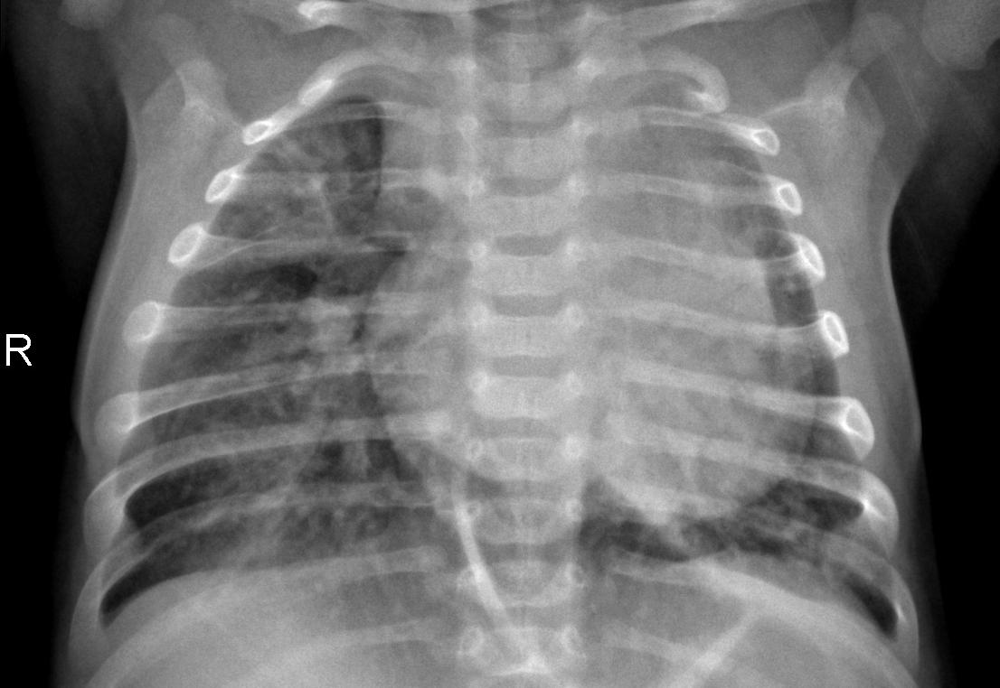

In [43]:
pneumonia_img # Asi se ve la imagen original

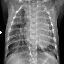

In [44]:
pneumonia_img_resized # Esta es la imagen con las dimensiones correctas para ingresarla a la red

In [45]:
pneumonia_img_array.shape # Esta es la dimensión del arreglo numérico que se ingresará a la red

(1, 64, 64, 1)

In [46]:
# Predecimos sobre el arreglo
cnn.predict(pneumonia_img_array)

array([[1.]], dtype=float32)

In [47]:
pneumonia_activations = get_activations(cnn,pneumonia_img_array)

En el siguiente gráfico vemos las 32 imágenes correspondientes a la salida de cada uno de los filtros de la capa de convolución.

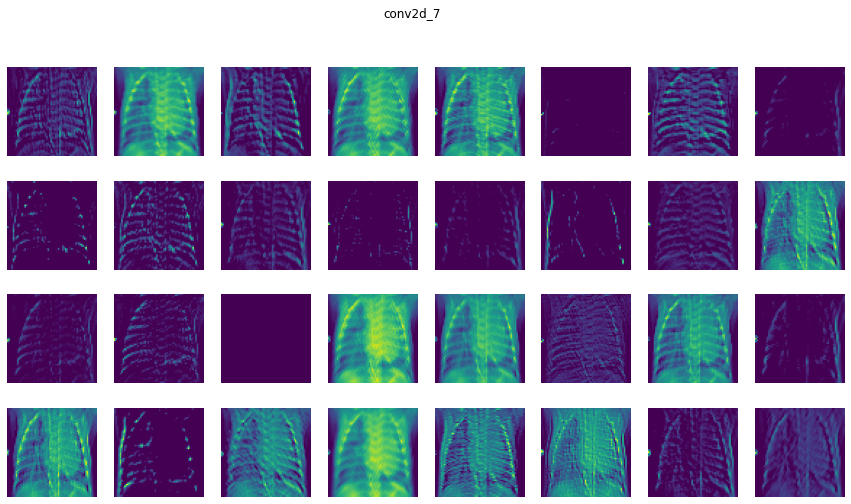

In [48]:
plot_conv_layer_result(pneumonia_activations,0)

En el siguiente gráfico observamos como la capa de max-pooling reduce la resolución de la imagen.

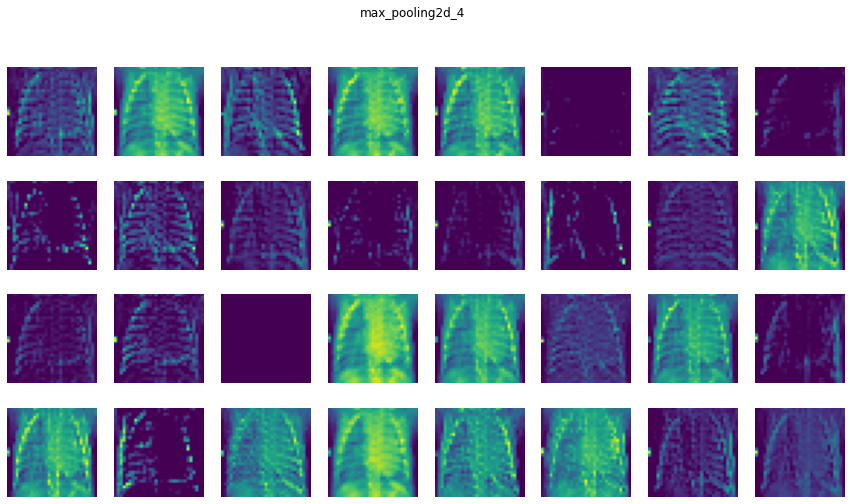

In [49]:
plot_conv_layer_result(pneumonia_activations,1)

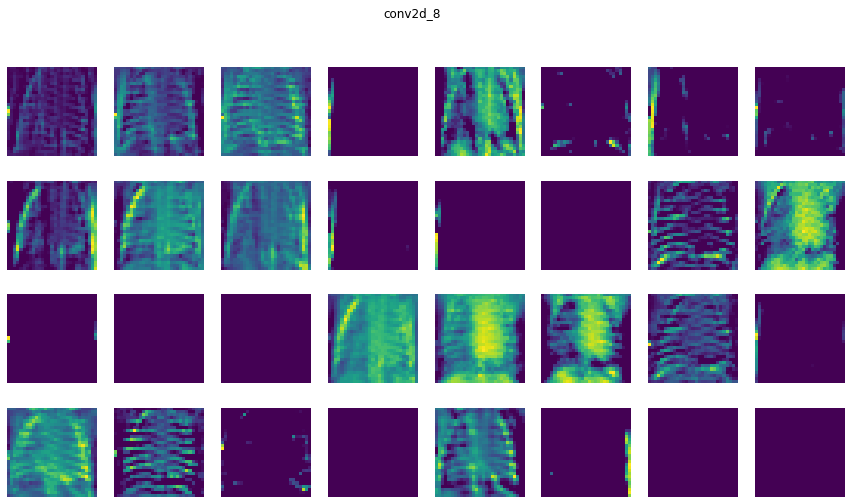

In [50]:
plot_conv_layer_result(pneumonia_activations,2)

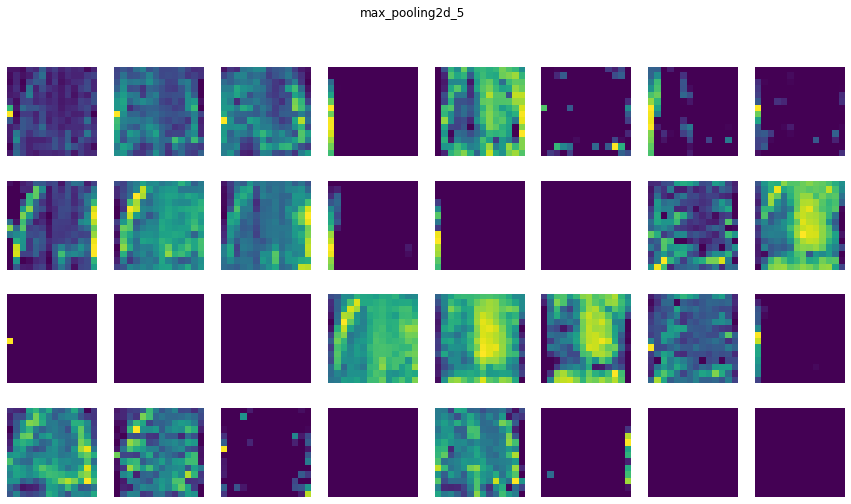

In [51]:
plot_conv_layer_result(pneumonia_activations,3)

Después del segundo max-pooling tenemos sólo arreglos unidimensionales, este primer resultado son todos los elementos del resultado anterior concatenados en un sólo arreglo.

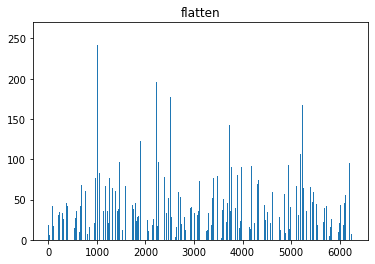

In [52]:
plot_1d_layer_result(pneumonia_activations,4)

Con la capa densa reducimos el número de elementos del arreglo anterior.

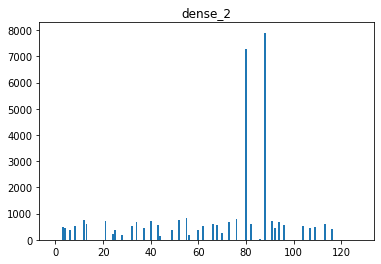

In [53]:
plot_1d_layer_result(pneumonia_activations,5)

La última capa tiene sólo 1 neurona correspondiente a la clasificación final de la red

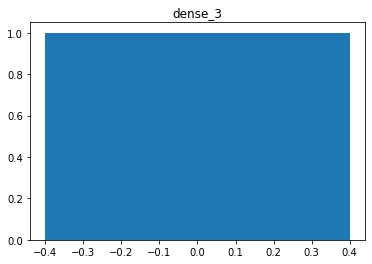

In [54]:
plot_1d_layer_result(pneumonia_activations,6)

#### Radiografía normal

In [55]:
normal_img, normal_img_resized, normal_img_array = image_loader("chest_xray/test/NORMAL/IM-0001-0001.jpeg")

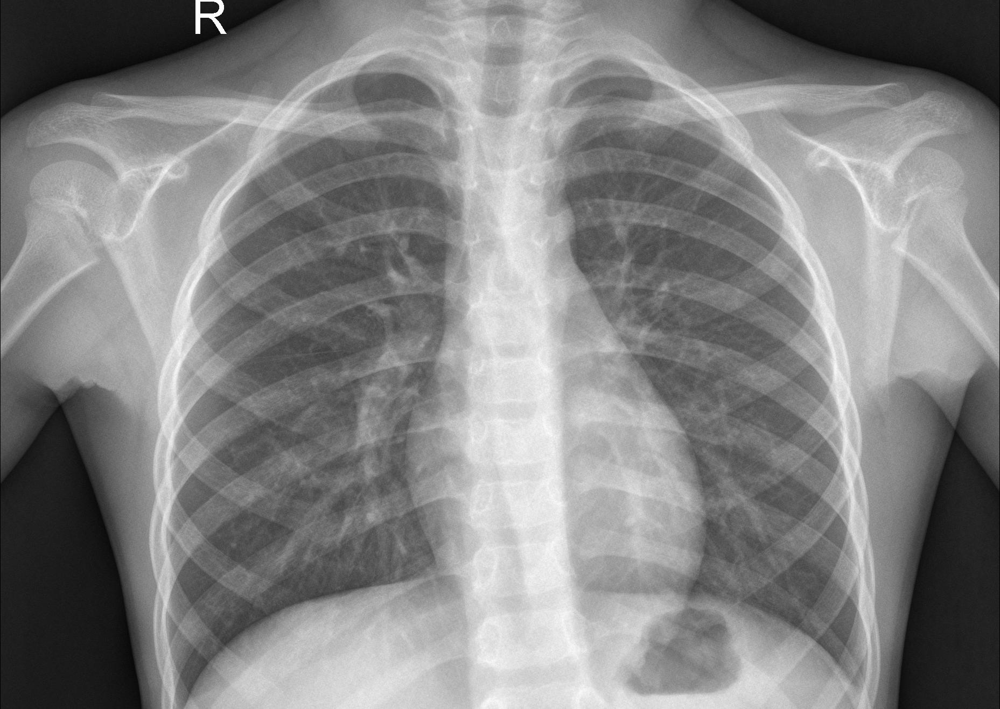

In [56]:
normal_img

In [57]:
cnn.predict(normal_img_array)

array([[0.]], dtype=float32)

In [58]:
normal_activations = get_activations(cnn,normal_img_array)

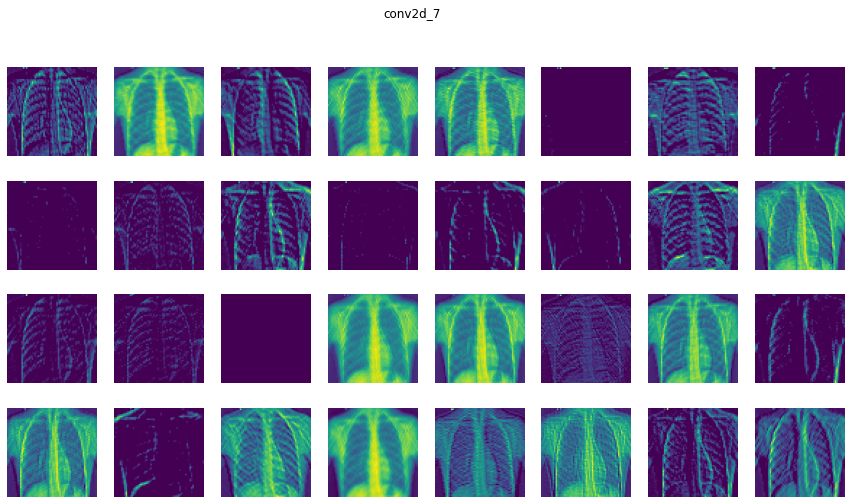

In [59]:
plot_conv_layer_result(normal_activations,0)

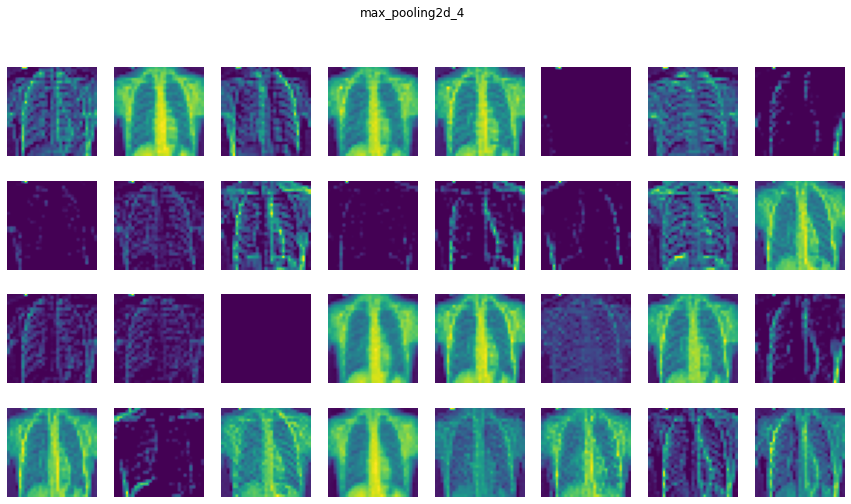

In [60]:
plot_conv_layer_result(normal_activations,1)

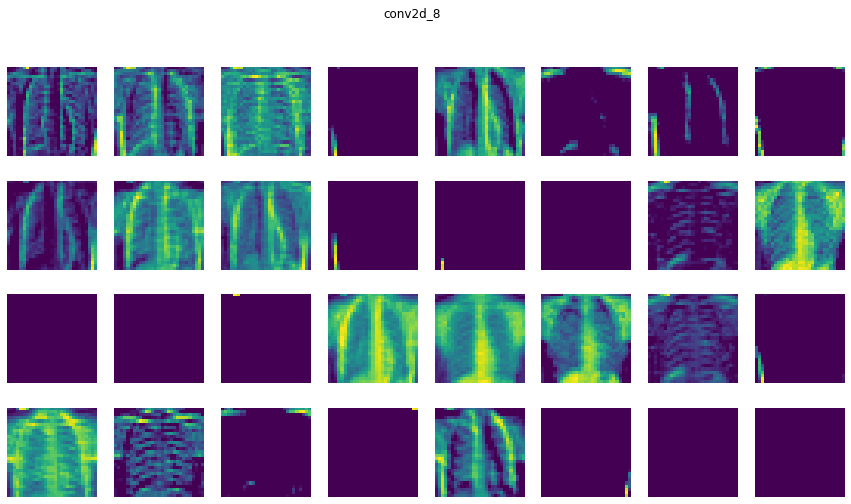

In [61]:
plot_conv_layer_result(normal_activations,2)

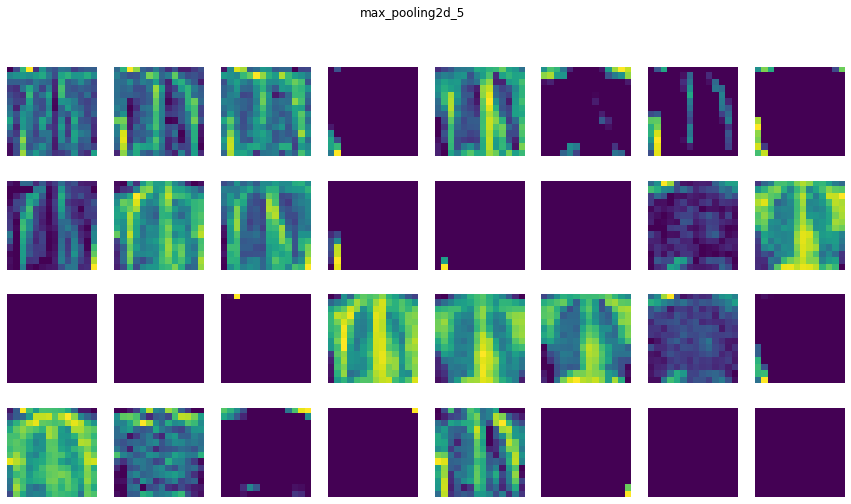

In [62]:
plot_conv_layer_result(normal_activations,3)

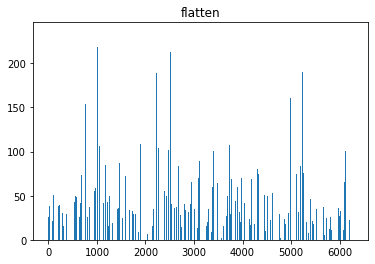

In [63]:
plot_1d_layer_result(normal_activations,4)

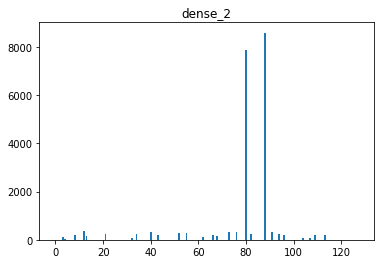

In [64]:
plot_1d_layer_result(normal_activations,5)

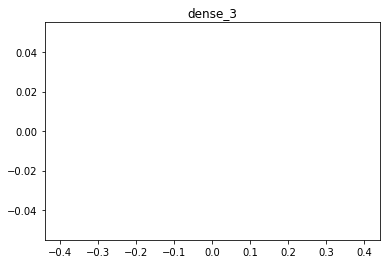

In [65]:
plot_1d_layer_result(normal_activations,6)

### Actividad 4

Modifica la arquitectura agregando una nueva capa de convolución y max-pooling prueba, si mejoran las métricas y visualiza las salidas de las capas.

In [81]:
# Construimos la arquitectura de la red neuronal

cnn_2 = tf.keras.Sequential()

cnn_2.add(tf.keras.layers.Conv2D(32, (3, 3), activation="relu", input_shape=(64, 64, 1))) # Capa de convolución

cnn_2.add(tf.keras.layers.MaxPooling2D(pool_size = (2, 2)))

cnn_2.add(tf.keras.layers.Conv2D(32, (3, 3), activation="relu"))

cnn_2.add(tf.keras.layers.MaxPooling2D(pool_size = (2, 2)))

cnn_2.add(tf.keras.layers.Conv2D(32, (3, 3), activation="relu"))

cnn_2.add(tf.keras.layers.MaxPooling2D(pool_size = (2, 2)))

cnn_2.add(tf.keras.layers.Flatten())

cnn_2.add(tf.keras.layers.Dense(activation = 'relu', units = 128))
cnn_2.add(tf.keras.layers.Dense(activation = 'sigmoid', units = 1))

cnn_2.compile(optimizer = 'adam', loss = 'binary_crossentropy', metrics = ['accuracy']) # Creamos la arquitectura

In [82]:
# Entrenamos la red neuronal

cnn_2_history = cnn_2.fit(training_set,
                         epochs = 10, # Entrenamos la red por 10 épocas
                         validation_data = val_set,
                         callbacks=[tensorboard_callback])

Epoch 1/10
163/163 [==============================] - 46s 281ms/step - loss: 0.5207 - accuracy: 0.7550 - val_loss: 0.5156 - val_accuracy: 0.7500
Epoch 2/10
163/163 [==============================] - 45s 274ms/step - loss: 0.2506 - accuracy: 0.8950 - val_loss: 0.6297 - val_accuracy: 0.6250
Epoch 3/10
163/163 [==============================] - 45s 274ms/step - loss: 0.2365 - accuracy: 0.9044 - val_loss: 1.0970 - val_accuracy: 0.5625
Epoch 4/10
163/163 [==============================] - 45s 274ms/step - loss: 0.2153 - accuracy: 0.9125 - val_loss: 1.2079 - val_accuracy: 0.5625
Epoch 5/10
163/163 [==============================] - 45s 274ms/step - loss: 0.1844 - accuracy: 0.9354 - val_loss: 0.7885 - val_accuracy: 0.6250
Epoch 6/10
163/163 [==============================] - 44s 272ms/step - loss: 0.1581 - accuracy: 0.9385 - val_loss: 0.6152 - val_accuracy: 0.6250
Epoch 7/10
163/163 [==============================] - 44s 272ms/step - loss: 0.1508 - accuracy: 0.9402 - val_loss: 0.6770 - val_ac

In [84]:
predictions_2 = cnn_2.predict(test_set, verbose = 1) > 0.5 # Predecimos sobre el conjunto de prueba

20/20 [==============================] - 4s 196ms/step


In [85]:
sklearn.metrics.confusion_matrix(test_set.classes, predictions_2) # Matriz de confusión

array([[173,  61],
       [  8, 382]])

In [86]:
print(sklearn.metrics.classification_report(test_set.classes, predictions_2)) # Resumen del rendimiento del modelo

              precision    recall  f1-score   support

           0       0.96      0.74      0.83       234
           1       0.86      0.98      0.92       390

    accuracy                           0.89       624
   macro avg       0.91      0.86      0.88       624
weighted avg       0.90      0.89      0.89       624



In [87]:
pneumonia_activations_2 = get_activations(cnn_2,pneumonia_img_array)

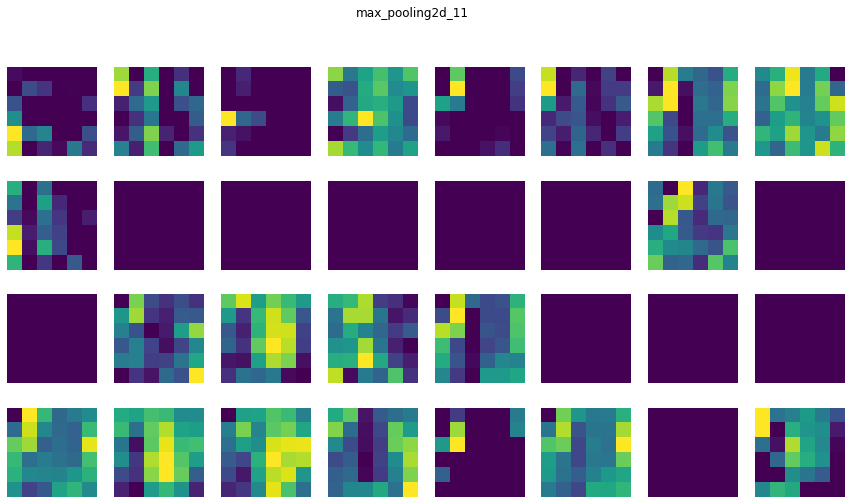

In [88]:
plot_conv_layer_result(pneumonia_activations_2,5)